In [ ]:
import pickle
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import plotly.express as px
from tqdm.notebook import tqdm

from sklearn.decomposition import PCA
from sklearn.cluster import MiniBatchKMeans, KMeans, AgglomerativeClustering, DBSCAN

from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score

class BaseClusteringExperiment:
    
    images_paths_filename = 'images_paths.csv'
    base_images_path = ['raw_data', 'veriwild']
    
    def __init__(self, descriptor_file="descriptors/efficientnet-b7.pickle", preprocess_pca_dim=200, n_clusters=8, descriptor=None, **kwargs):
        self.n_clusters = n_clusters
        self.descriptor_file = descriptor_file
        self.preprocess_pca_dim = preprocess_pca_dim
        
        if descriptor is not None:
            self.descriptor = descriptor
        else:
            self.descriptor = self._build_descriptor()
        
        self.images_paths = self._build_images_paths()
        
        self._labels = None
        
        self.model = self._build_model(**kwargs)
        
        return
    
    def _build_descriptor(self):
        print("loading descriptor", self.descriptor_file)
        with open(self.descriptor_file, 'rb') as f:
            descriptor = pickle.load(f)
        return descriptor
    
    def _build_images_paths(self):
        images_paths = pd.read_csv(self.images_paths_filename)
        # fix os separator
        images_paths['paths'] = images_paths['paths'].apply(lambda x: os.path.join(* (self.base_images_path + x.split("\\")) ))
        return images_paths
    
    def draw_samples(self, label, nrows=3, ncols=3, figsize=(15,15)):
        samples_indexes = np.nonzero( self.labels() == label )[0]
        np.random.shuffle(samples_indexes)
        paths = self.images_paths.iloc[samples_indexes]['paths']
        
        f, axarr = plt.subplots(nrows,ncols)
        f.set_size_inches(*figsize)
        f.suptitle(f"Images from cluster {label}", fontsize=16)
        for i in range(nrows):
            for j in range(ncols):
                path_idx = i * ncols + j
                if path_idx >= len(paths):
                    break
                path = paths.iloc[ path_idx ]
                img = mpimg.imread(path)
                plt.imshow(img)
                axarr[i,j].imshow( img )
                axarr[i,j].axis('off')
                
        return
    
    def labels(self):
        if self._labels is None:
            self._labels = self.clustering()
        return self._labels
    
    def _build_model(self):
        raise NotImplemented
    
    def clustering(self):
        self._clustering_preprocess()

        print("fitting model...")
        self.model.fit( self.descriptor )
        
        return self.model.labels_
    
    def draw_clustered(self):
        image_pca = PCA(n_components=2, copy=True)
        descriptor_pcaed = image_pca.fit_transform( self.descriptor )
        
        labels = np.expand_dims(self.labels(), axis=1)
        data_transformed_df = pd.DataFrame(np.hstack([descriptor_pcaed, labels]), columns=['x', 'y', 'cluster'])
        data_transformed_df['cluster'] = data_transformed_df['cluster'].astype(str)
        fig = px.scatter(data_transformed_df, x='x', y='y', color='cluster')
        fig.show()
        
        return
    
    def count_metrics(self):
        unique, counts = np.unique(self.labels(), return_counts=True)
        return {
            "calinski_harabasz_score": calinski_harabasz_score(self.descriptor, self.labels()),
            "davies_bouldin_score": davies_bouldin_score(self.descriptor, self.labels()),
            "cluster elements counts": dict(zip(unique, counts)),
            "total labeled elements": len(self.labels()),
        }
    
    def report_experiment(self, draw_clustered=False):
        print(self.count_metrics())
        
        for i, label in enumerate(np.unique(self.labels())):
            plt.figure(i)
            self.draw_samples(label, ncols=10, nrows=5, figsize=(15,7))
        
        if draw_clustered:
            self.draw_clustered()
        return
        
    def _clustering_preprocess(self):
        
        if self.descriptor.shape[1] <= self.preprocess_pca_dim:
            return
        
        print("performing preprocess PCA...")
        pca = PCA(n_components=self.preprocess_pca_dim, copy=False)
        descriptor_pcaed = pca.fit_transform(self.descriptor)
        print("self.descriptor.shape", self.descriptor.shape, "descriptor_pcaed.shape", descriptor_pcaed.shape)
        self.descriptor = descriptor_pcaed

        return
    
    
class MiniBatchKMeansClusteringExperiment(BaseClusteringExperiment):
    def _build_model(self):
        return MiniBatchKMeans(n_clusters=self.n_clusters, random_state=0, batch_size=500, max_iter=1000)
    
class KMeansClusteringExperiment(BaseClusteringExperiment):
    def _build_model(self):
        return KMeans(n_clusters=self.n_clusters, random_state=0, max_iter=1000)
    
class DBSCANClusteringExperiment(BaseClusteringExperiment):
    def _build_model(self, **kwargs):
        return DBSCAN(n_jobs=-1, metric=kwargs.get('metric','cosine'), eps=kwargs.get('eps', 0.05), min_samples=kwargs.get('min_samples', 5))
    

#### уменьшение размерности всех дескрипторов до 200

In [ ]:
descriptors_files = [ 'descriptors/efficientnet-b7.pickle', 'descriptors/vdc_color.pickle', 'descriptors/vdc_type.pickle', 'descriptors/osnet.pickle' ]

for desc_file in descriptors_files:
    base_exp = KMeansClusteringExperiment(descriptor_file=desc_file)
    base_exp._clustering_preprocess()
    
    desc_file_name_200 = desc_file.replace('.pickle', f'{base_exp.descriptor.shape[1]}.pickle')
    with open(desc_file_name_200, 'wb') as desc_file_200:
        pickle.dump(base_exp.descriptor, desc_file_200)


loading descriptor descriptors/osnet.pickle
performing preprocess PCA...
self.descriptor.shape (416314, 512) descriptor_pcaed.shape (416314, 200)


### osnet + mini batch kmeans

кластеризуется по цветам

loading descriptor descriptors/osnet200.pickle
fitting model...
{'calinski_harabasz_score': 23471.592562493217, 'davies_bouldin_score': 2.7257751481537538}
cluster elements counts: {0: 61943, 1: 51627, 2: 57250, 3: 45769, 4: 26486, 5: 30221, 6: 22431, 7: 38997, 8: 25622, 9: 55968}
total labeled elements: 416314
CPU times: user 18.8 s, sys: 601 ms, total: 19.4 s
Wall time: 30.3 s


<Figure size 432x288 with 0 Axes>

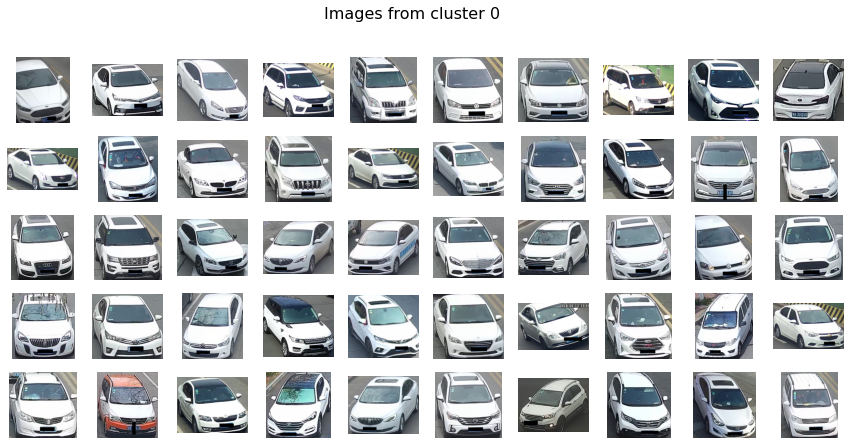

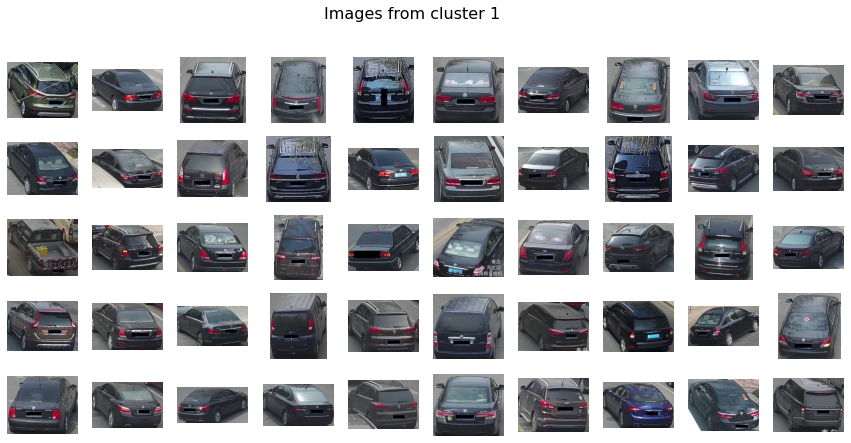

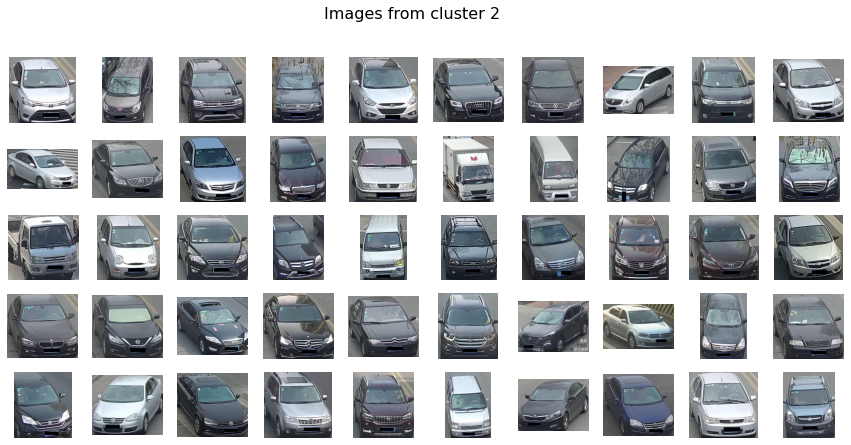

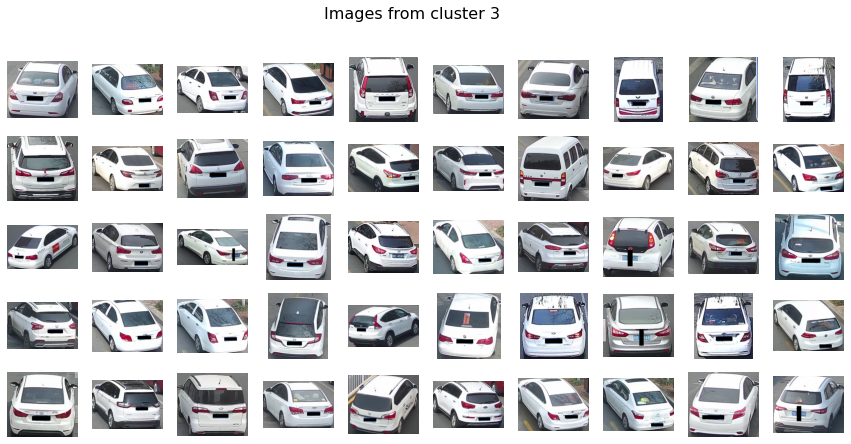

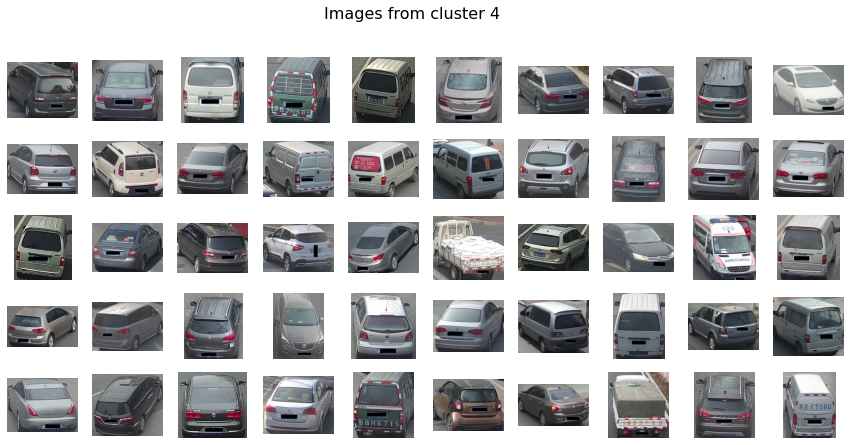

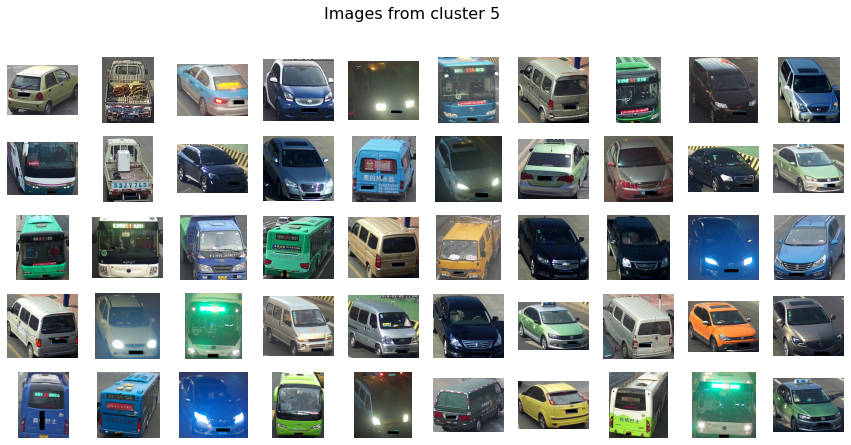

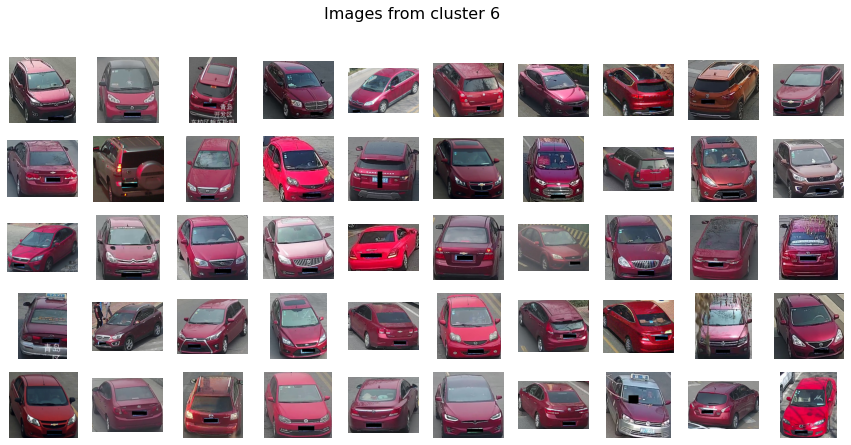

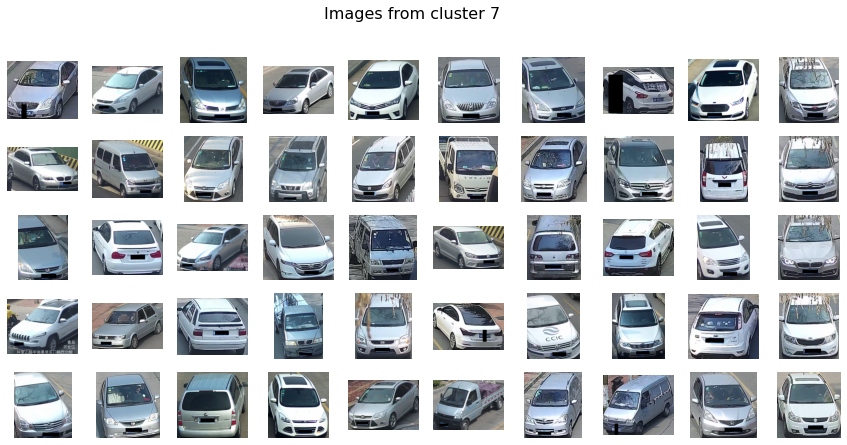

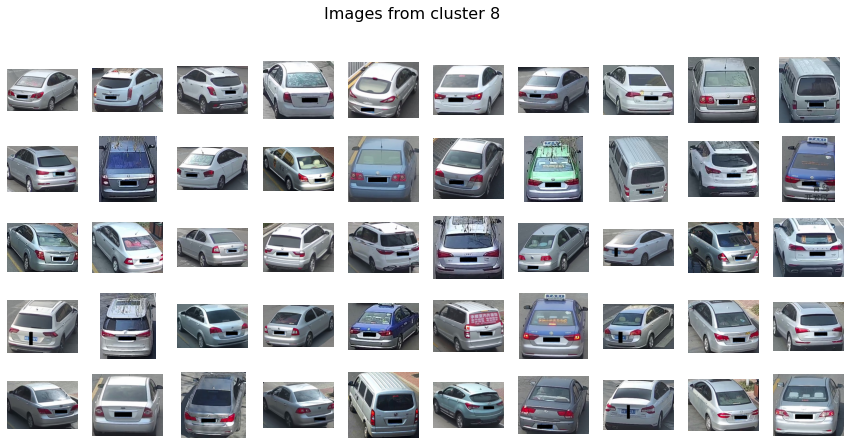

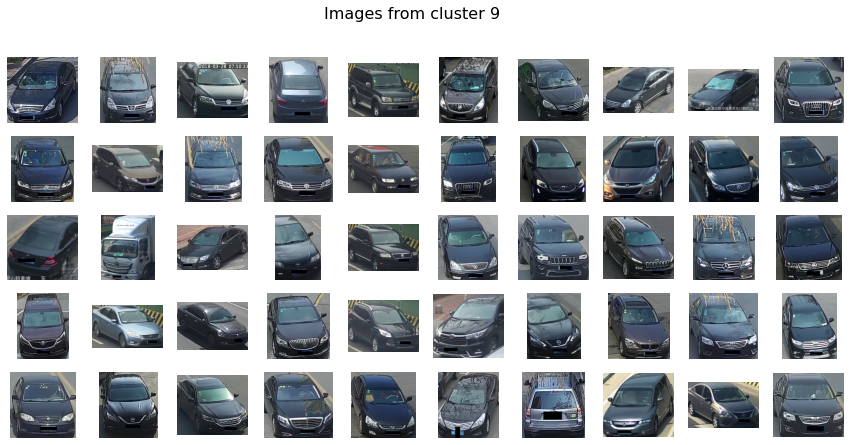

In [ ]:
%%time
osnet_exp = MiniBatchKMeansClusteringExperiment(descriptor_file="descriptors/osnet200.pickle", n_clusters=10)
osnet_exp.report_experiment()

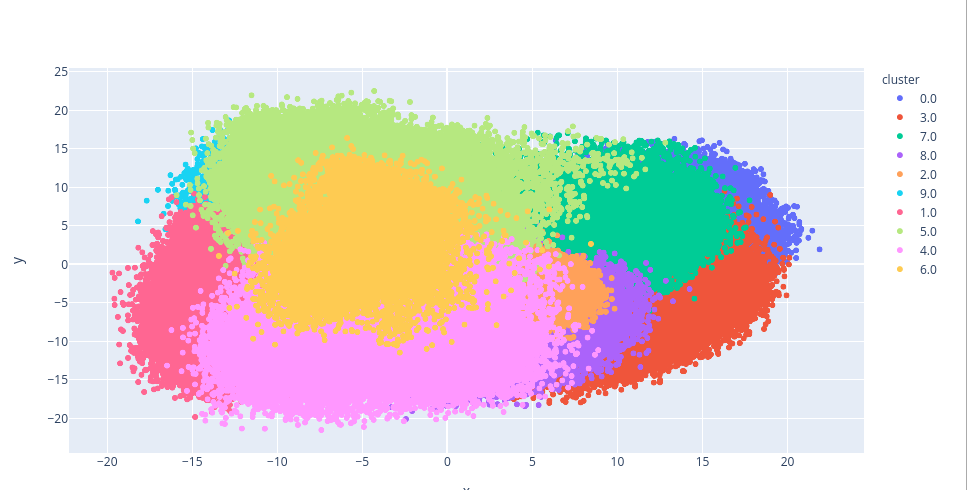

### efficientnet + MiniBatchKMeans не интерпретинуются

loading descriptor descriptors/efficientnet-b7200.pickle
fitting model...
{'calinski_harabasz_score': 9052.051134388184, 'davies_bouldin_score': 4.987961755309382, 'cluster elements counts': {0: 38200, 1: 35476, 2: 47822, 3: 50181, 4: 20617, 5: 61095, 6: 44375, 7: 49681, 8: 6595, 9: 62272}, 'total labeled elements': 416314}
CPU times: user 18.6 s, sys: 495 ms, total: 19.1 s
Wall time: 25.5 s


<Figure size 432x288 with 0 Axes>

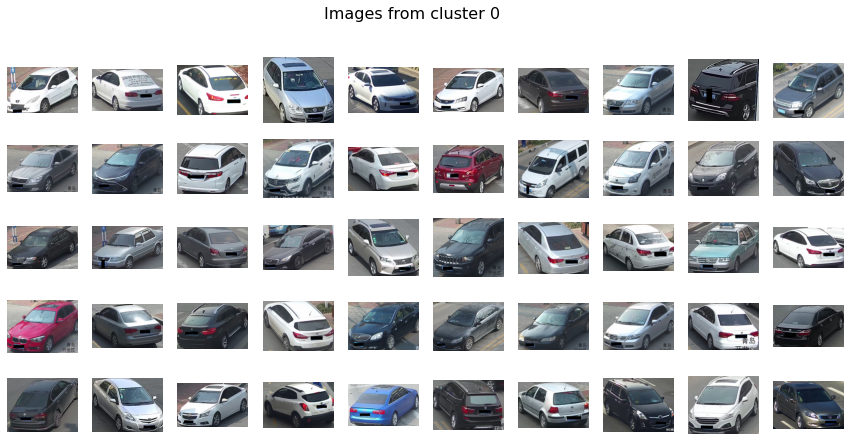

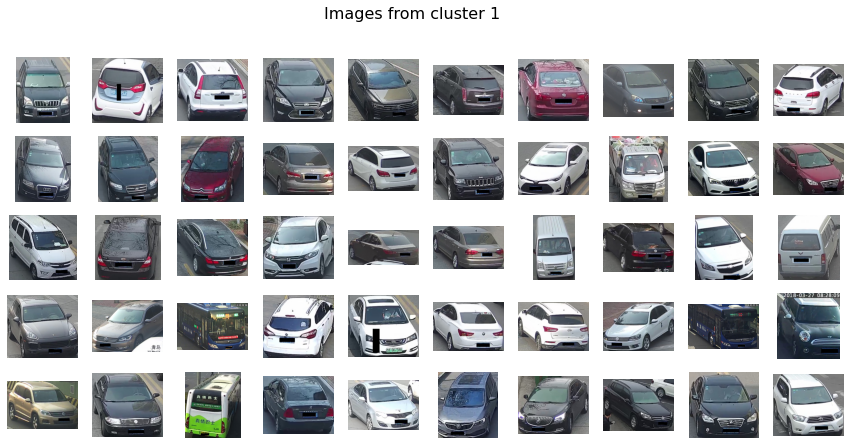

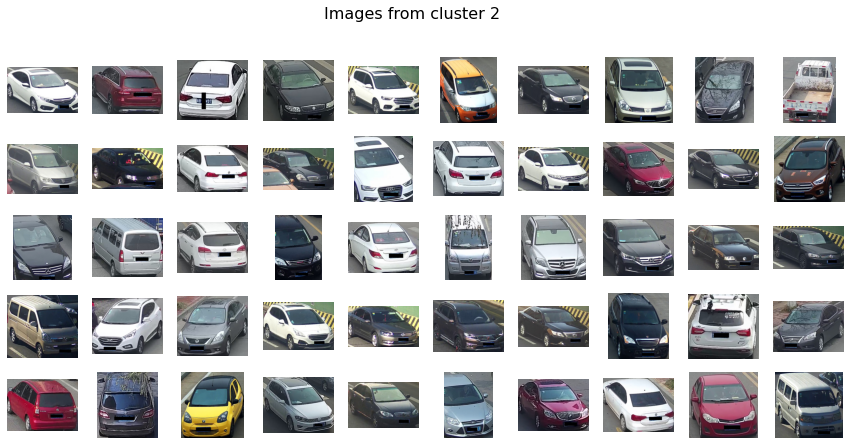

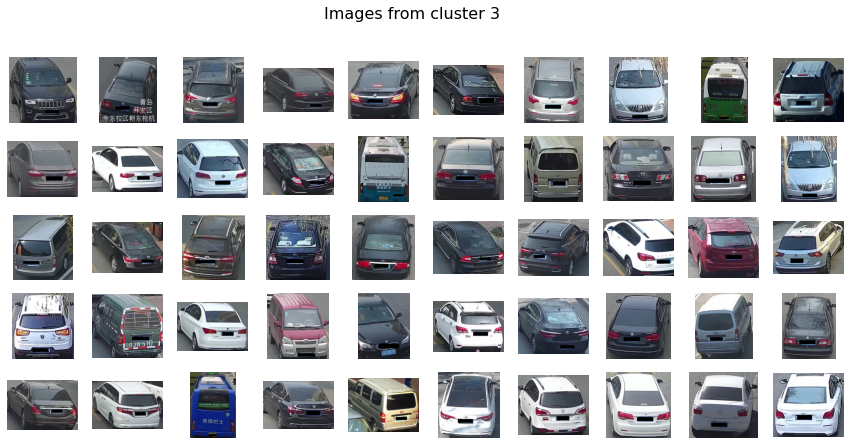

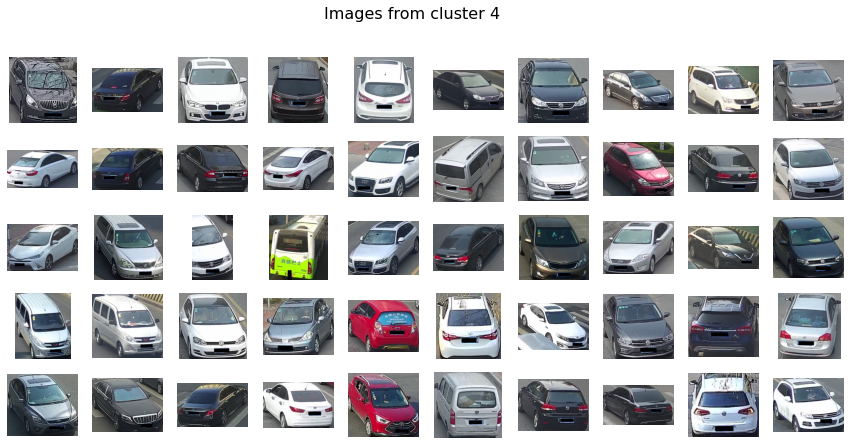

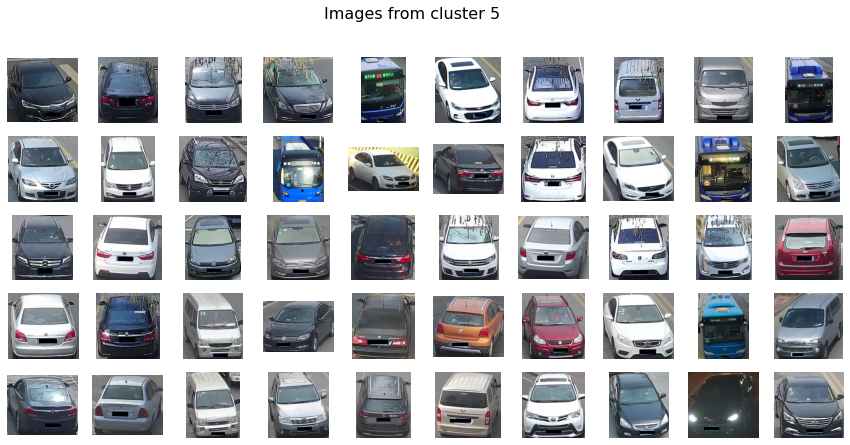

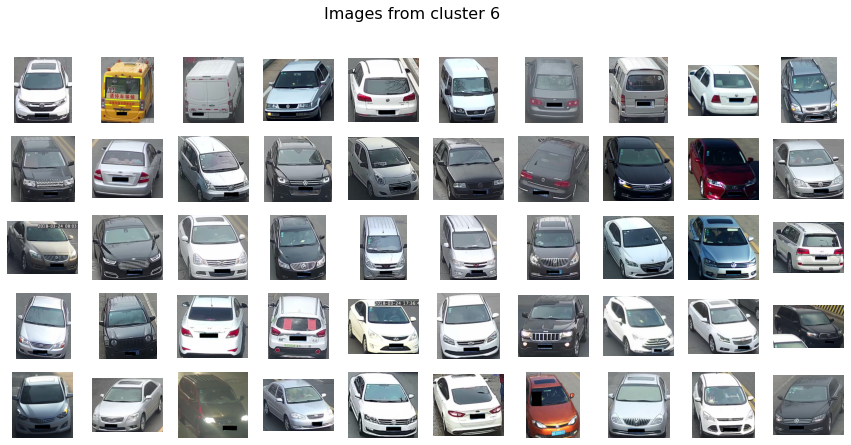

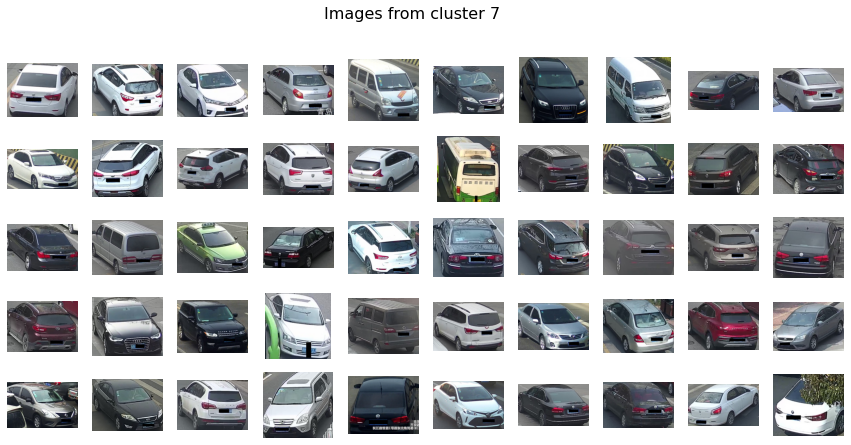

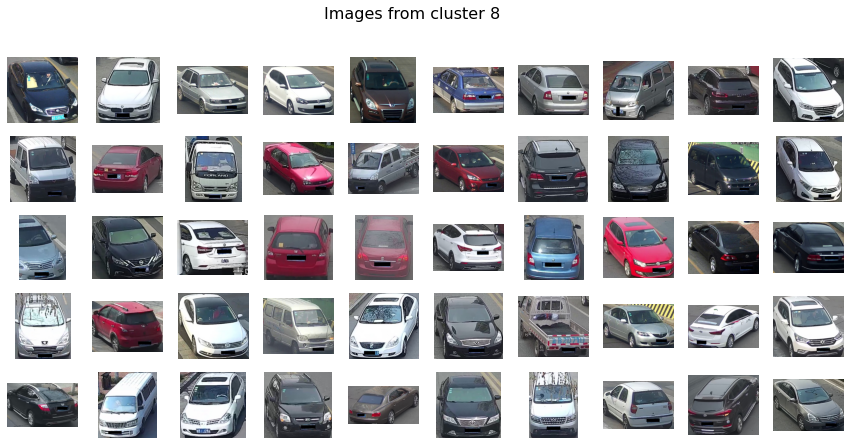

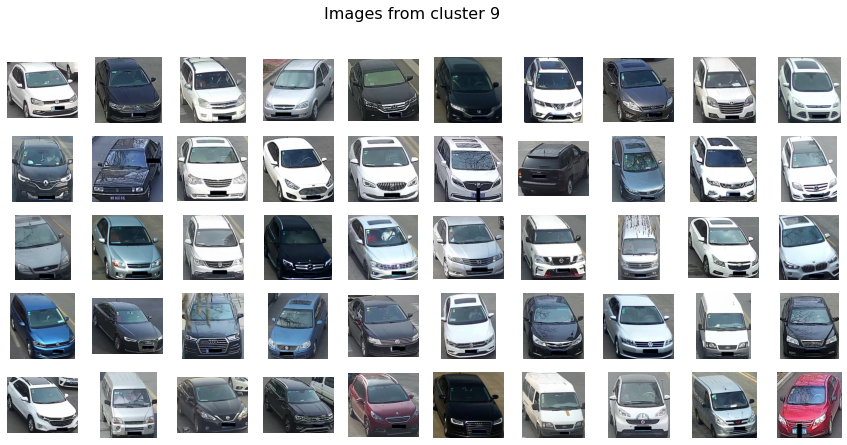

In [ ]:
%%time
eff_net_exp = MiniBatchKMeansClusteringExperiment(descriptor_file="descriptors/efficientnet-b7200.pickle", n_clusters=10)
eff_net_exp.report_experiment()

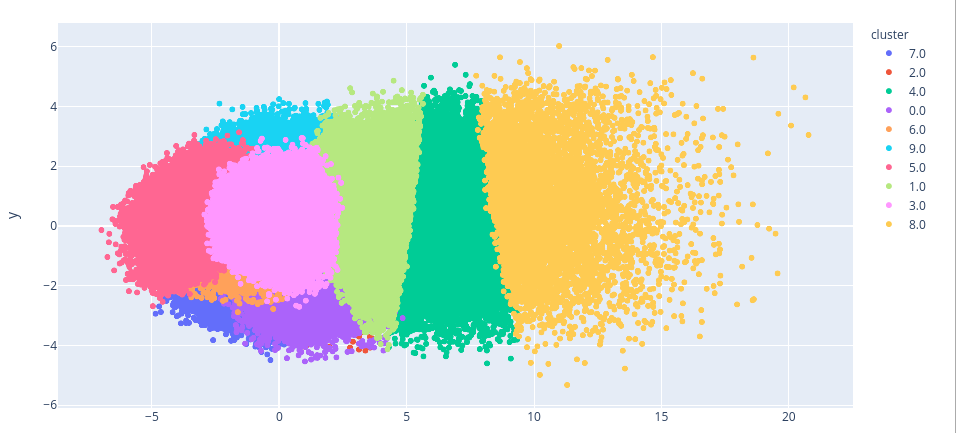

### vdc_color128 + MiniBatchKMeans по 4 кластерам:
* белые
* черные
* холодные цвета
* теплые цвета

loading descriptor descriptors/vdc_color128.pickle
fitting model...
{'calinski_harabasz_score': 111654.31276283249, 'davies_bouldin_score': 1.821031769826829, 'cluster elements counts': {0: 143220, 1: 145300, 2: 101769, 3: 26025}, 'total labeled elements': 416314}
CPU times: user 8.8 s, sys: 256 ms, total: 9.06 s
Wall time: 12.4 s


<Figure size 432x288 with 0 Axes>

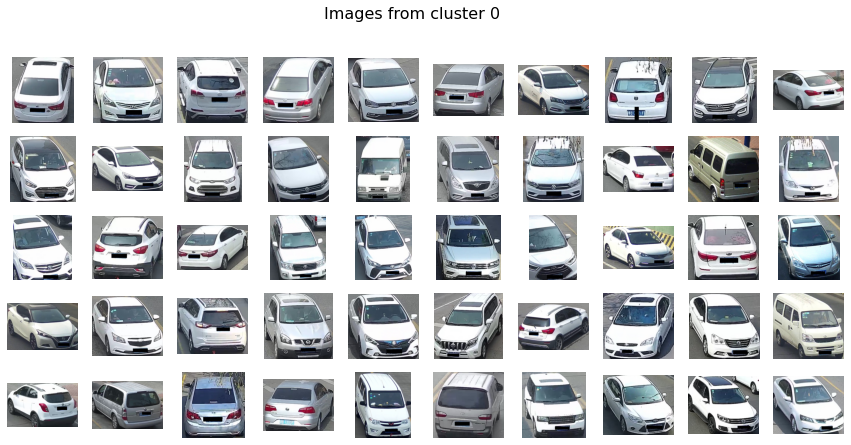

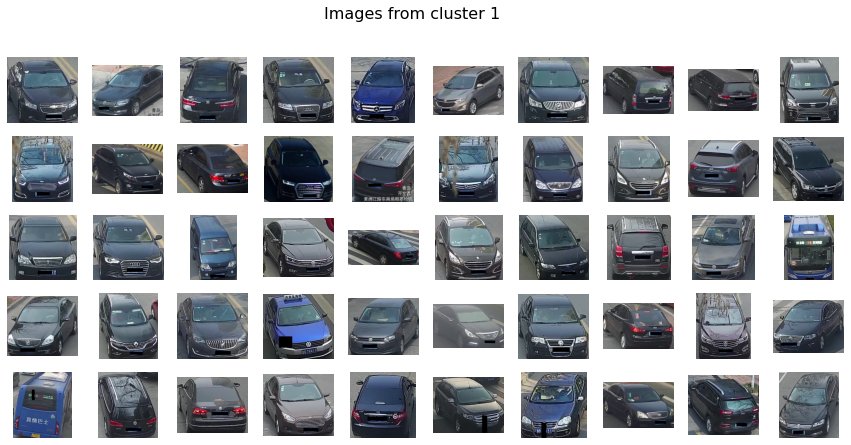

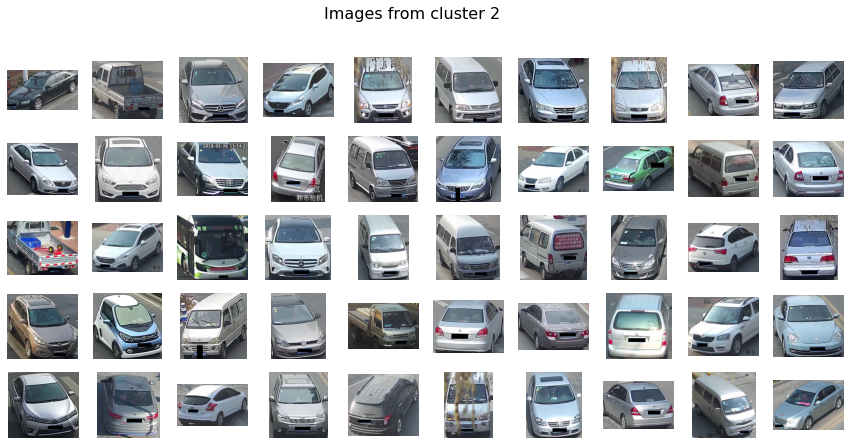

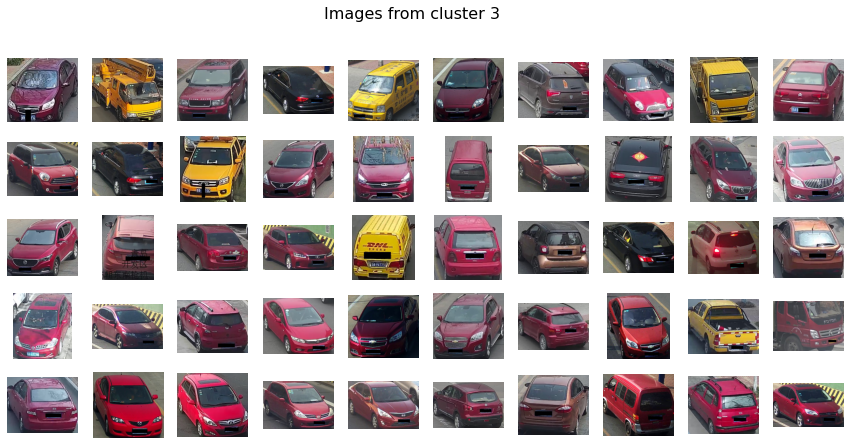

In [ ]:
%%time
vdc_color128 = MiniBatchKMeansClusteringExperiment(descriptor_file="descriptors/vdc_color128.pickle", n_clusters=4)
vdc_color128.report_experiment()

In [ ]:
vdc_color128.draw_clustered()

![image.png](attachment:image.png)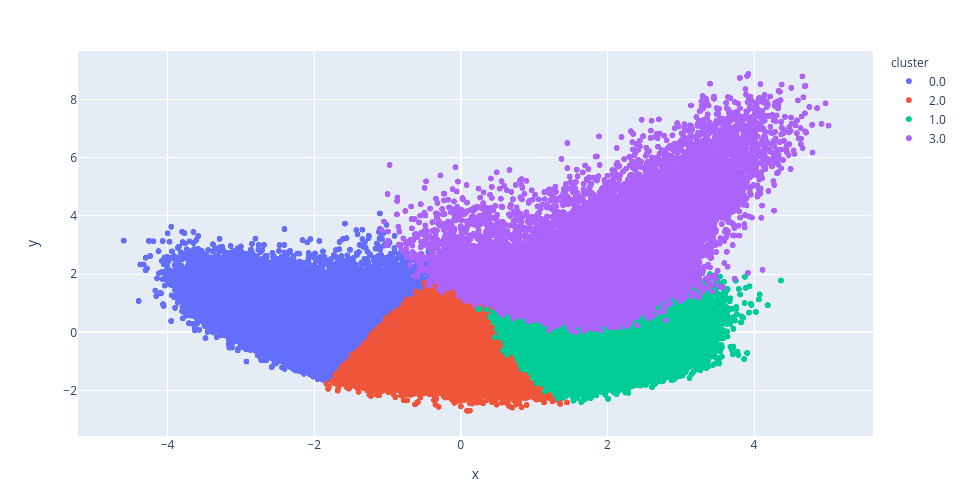

#### vdc_type200 MiniBatchKMeans 4 кластера
* минивэн/автобусы/грузовые
* легковые
* легковые
* внедорожники

3 кластера лучше метрики, но интерпретировать их не удалось

loading descriptor descriptors/vdc_type200.pickle
fitting model...
{'calinski_harabasz_score': 119597.14263983352, 'davies_bouldin_score': 1.6415449981032093, 'cluster elements counts': {0: 67892, 1: 83421, 2: 164884, 3: 100117}, 'total labeled elements': 416314}
CPU times: user 8.35 s, sys: 273 ms, total: 8.63 s
Wall time: 10.6 s


<Figure size 432x288 with 0 Axes>

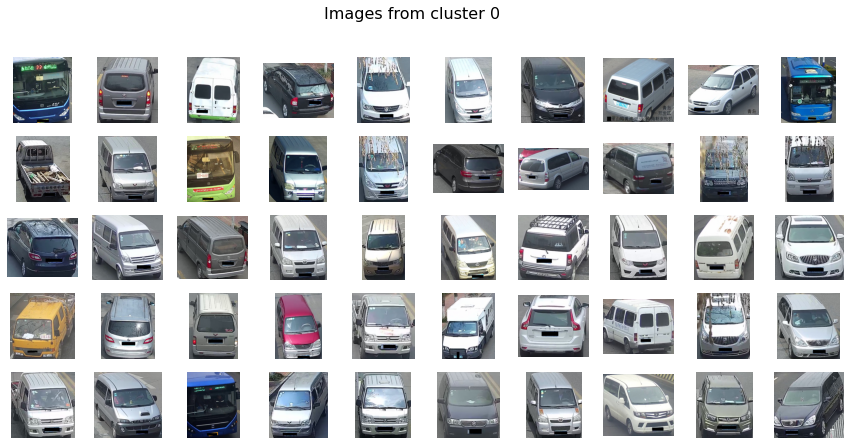

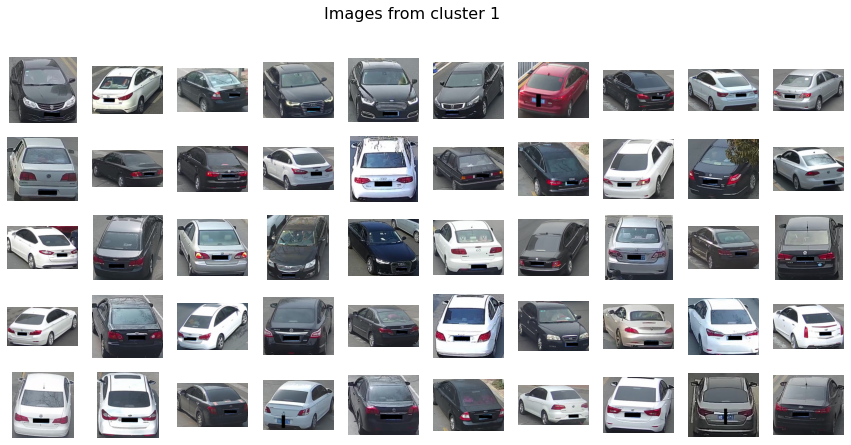

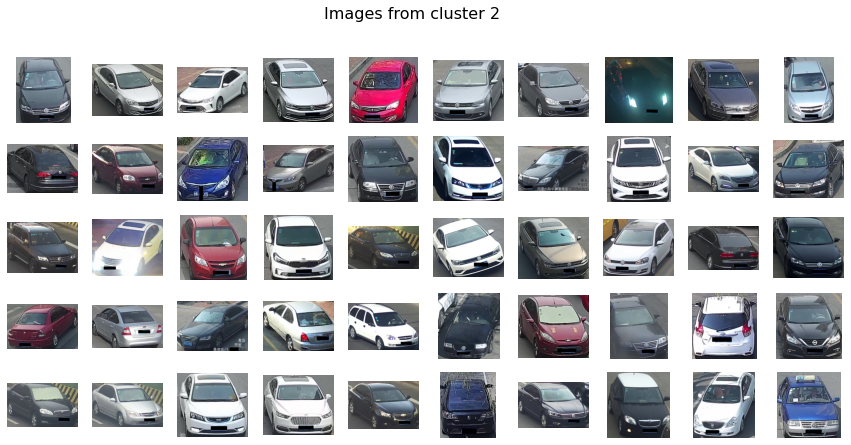

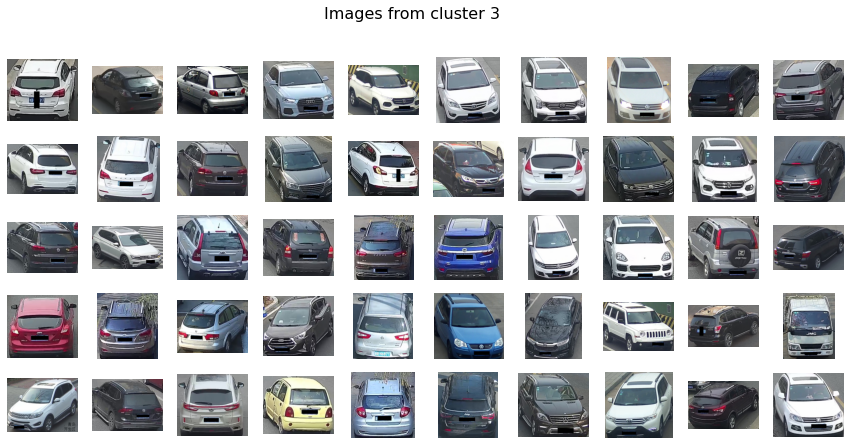

In [ ]:
%%time
vdc_type200 = MiniBatchKMeansClusteringExperiment(descriptor_file="descriptors/vdc_type200.pickle", n_clusters=4)
vdc_type200.report_experiment()

In [ ]:
vdc_type200.draw_clustered()

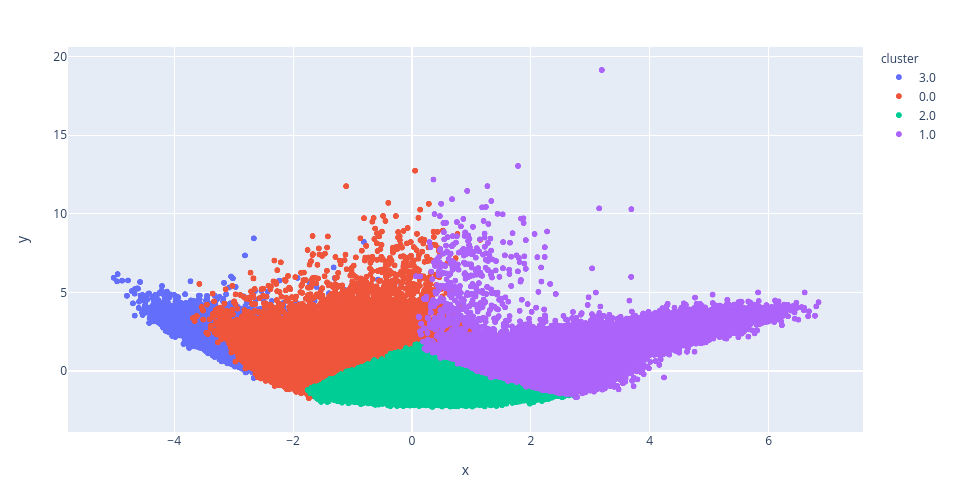

### dbscan поддерживает косинусное расстояние и евклидово

### dbscan + efficient net

Но оба варианта с различными eps'ами работают не очень хорошо, мне не удалось их проинтерпретировать

loading descriptor descriptors/efficientnet-b7200.pickle
fitting model...
{'calinski_harabasz_score': 588.9470907314004, 'davies_bouldin_score': 3.5018245127872705}
cluster elements counts: {-1: 2309, 0: 6018}
total labeled elements: 8327
CPU times: user 57.7 s, sys: 122 ms, total: 57.8 s
Wall time: 11.7 s


<Figure size 432x288 with 0 Axes>

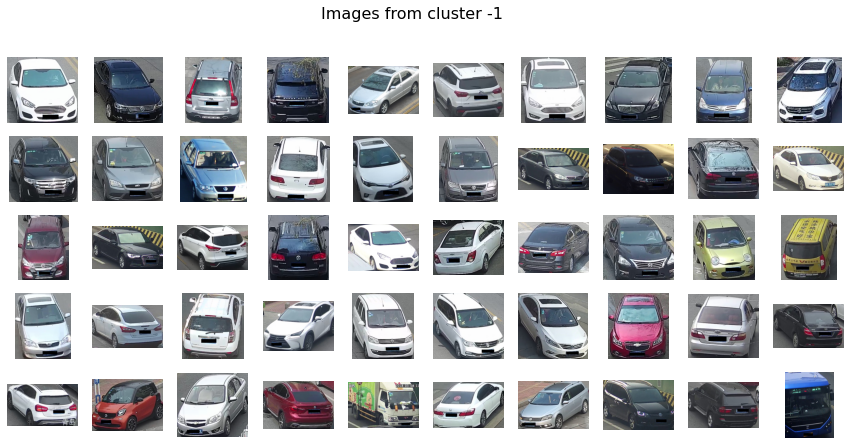

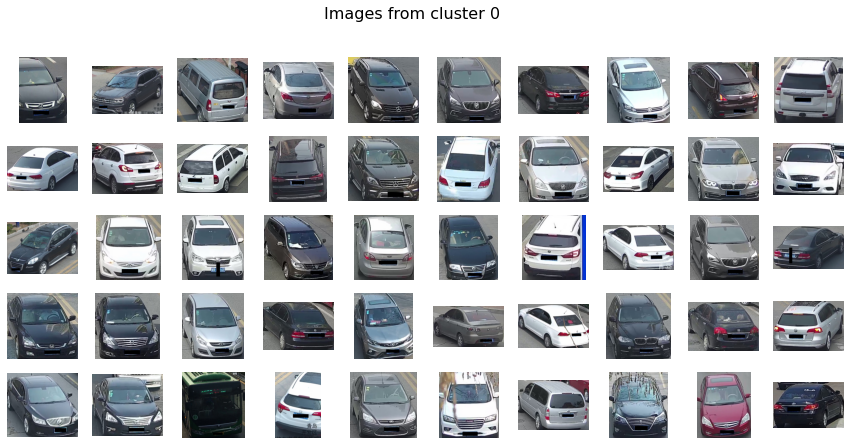

In [ ]:
%%time
dbscan_exp = DBSCANClusteringExperiment(descriptor_file='descriptors/efficientnet-b7200.pickle', eps=8, min_samples=10, metric='euclidean')
dbscan_exp.descriptor = dbscan_exp.descriptor[::50, :] # в N раз уменьшим кол-во элементов для обучения
dbscan_exp.report_experiment()

loading descriptor descriptors/efficientnet-b7200.pickle
fitting model...
{'calinski_harabasz_score': 376.76557096480315, 'davies_bouldin_score': 3.139223613559507}
cluster elements counts: {-1: 7211, 0: 658, 1: 458}
total labeled elements: 8327
CPU times: user 8.31 s, sys: 283 ms, total: 8.59 s
Wall time: 7.16 s


<Figure size 432x288 with 0 Axes>

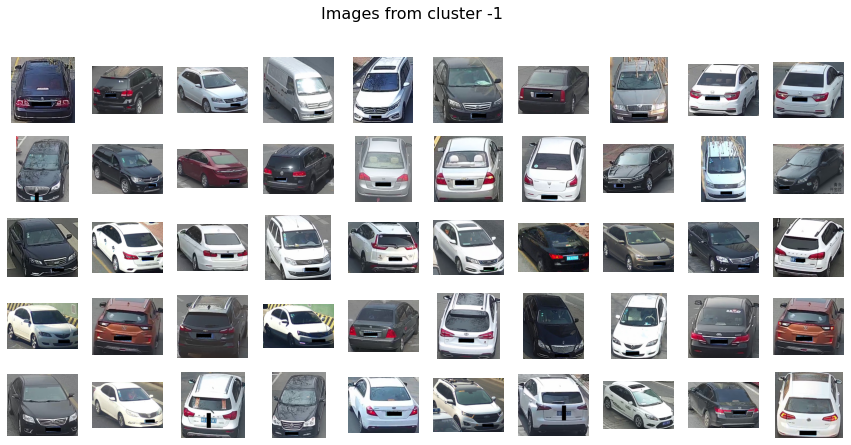

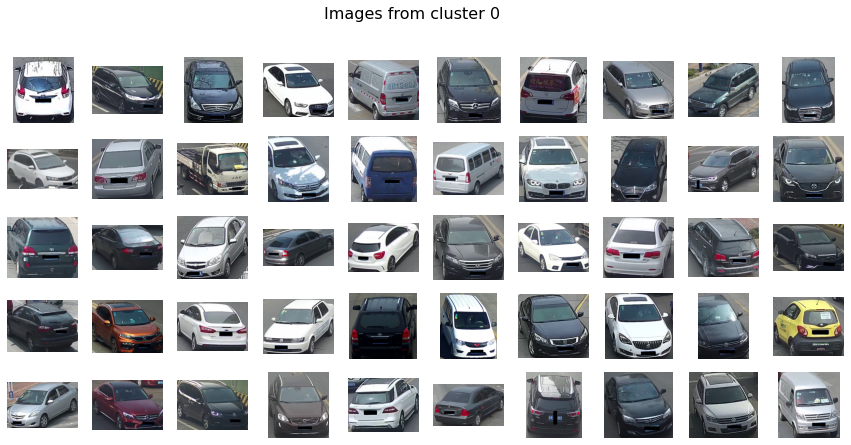

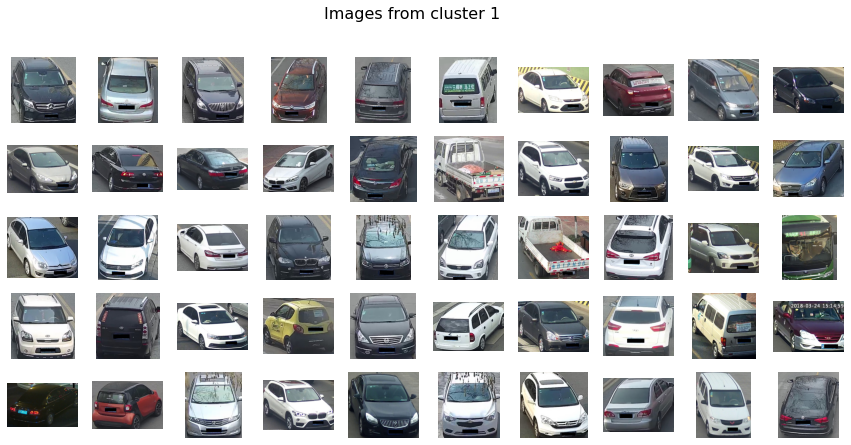

In [ ]:
%%time
dbscan_exp = DBSCANClusteringExperiment(descriptor_file='descriptors/efficientnet-b7200.pickle', eps=0.46, min_samples=10, metric='cosine')
dbscan_exp.descriptor = dbscan_exp.descriptor[::50, :] # в N раз уменьшим кол-во элементов для обучения
dbscan_exp.report_experiment()

### dbscan + osnet

тоже не получается подобрать eps так, чтобы кластеры были более-менее полными

И хотя с методом kmeans эти дескрипторы хорошо интерпретируются, с помощью dbscan не удалось добиться похожего результата


loading descriptor descriptors/osnet200.pickle
fitting model...
{'calinski_harabasz_score': 45.75328603974337, 'davies_bouldin_score': 2.966826416372416}
cluster elements counts: {-1: 195, 0: 8075, 1: 32, 2: 25}
total labeled elements: 8327
CPU times: user 58.1 s, sys: 103 ms, total: 58.2 s
Wall time: 13.6 s


<Figure size 432x288 with 0 Axes>

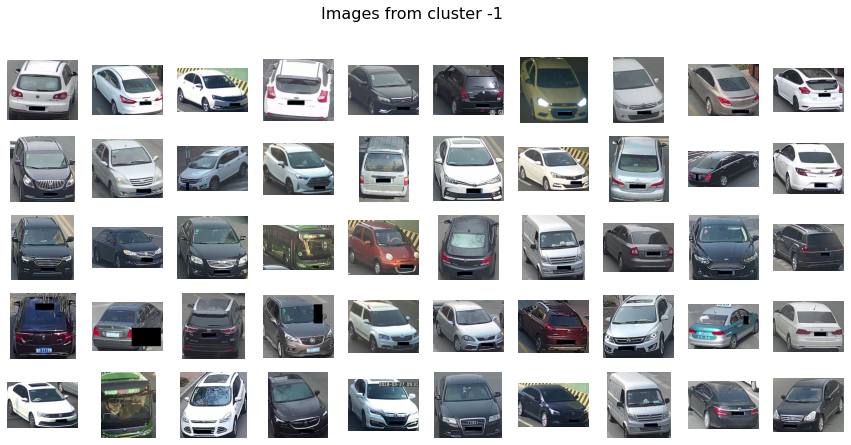

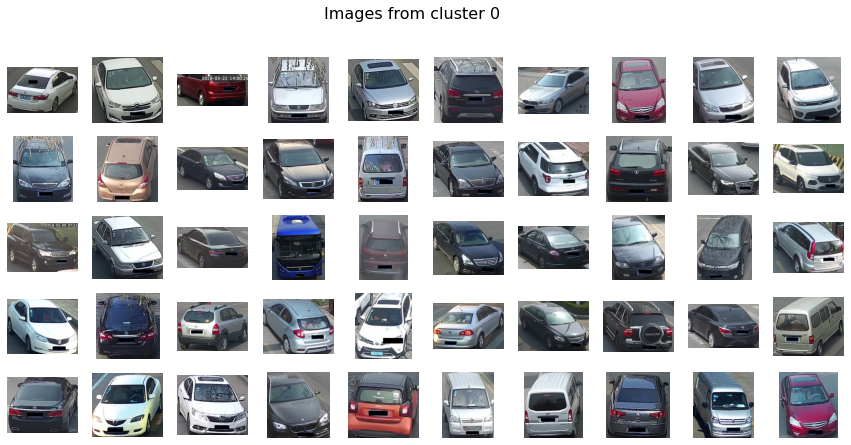

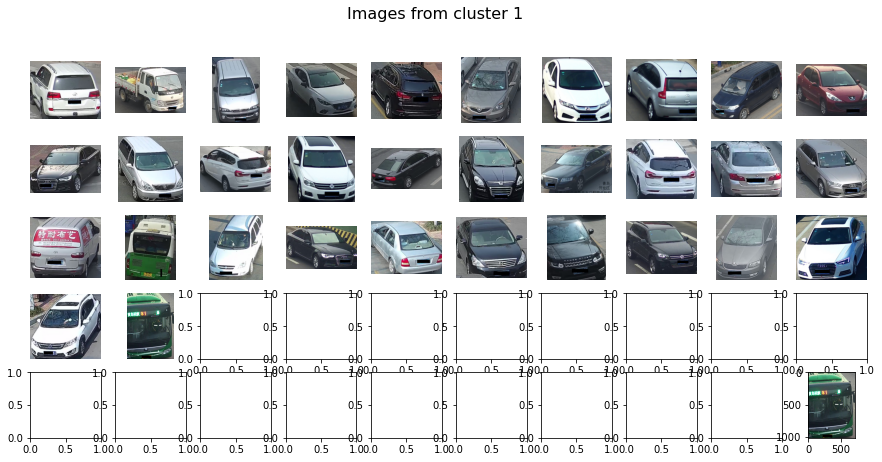

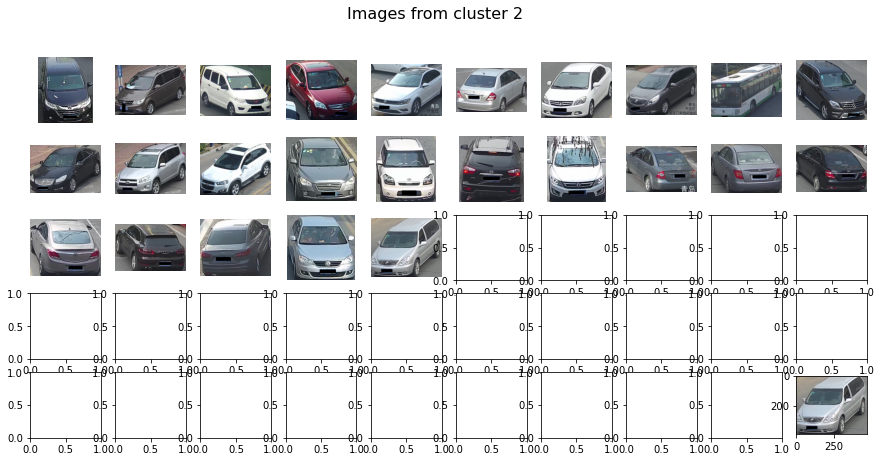

In [ ]:
%%time
dbscan_exp = DBSCANClusteringExperiment(descriptor_file='descriptors/osnet200.pickle', eps=23, min_samples=10, metric='euclidean')
dbscan_exp.descriptor = dbscan_exp.descriptor[::50, :] # в N раз уменьшим кол-во элементов для обучения
dbscan_exp.report_experiment()

loading descriptor descriptors/osnet200.pickle
fitting model...
{'calinski_harabasz_score': 20.756447211202744, 'davies_bouldin_score': 9.19461561985947}
cluster elements counts: {-1: 507, 0: 7820}
total labeled elements: 8327
CPU times: user 6.79 s, sys: 302 ms, total: 7.09 s
Wall time: 5.3 s


<Figure size 432x288 with 0 Axes>

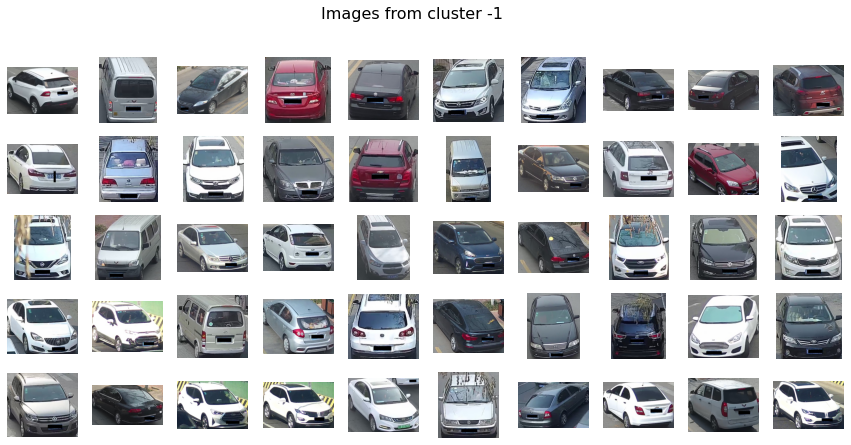

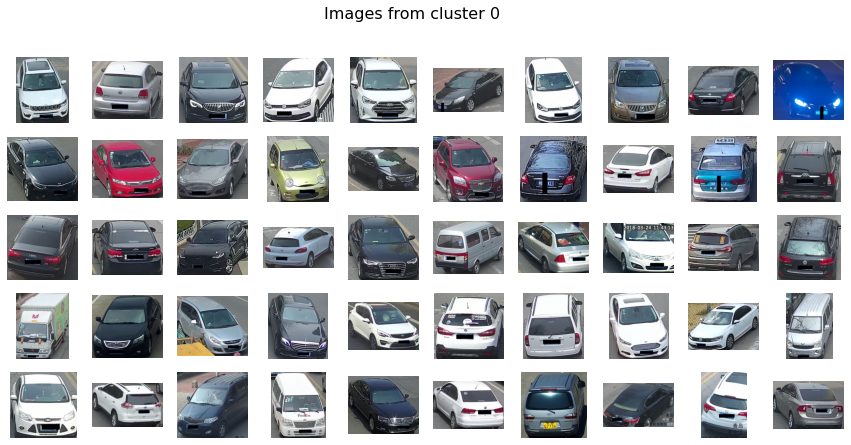

In [ ]:
%%time
dbscan_exp = DBSCANClusteringExperiment(descriptor_file='descriptors/osnet200.pickle', eps=0.36, min_samples=10, metric='cosine')
dbscan_exp.descriptor = dbscan_exp.descriptor[::50, :] # в N раз уменьшим кол-во элементов для обучения
dbscan_exp.report_experiment()